<a href="https://colab.research.google.com/github/samikshagadhave/binary_classification/blob/main/Binary_classification_for_Good_%26_Bad_dataset_with_ResNet50_model.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from google.colab import drive
drive.mount("/content/gdrive")

Mounted at /content/gdrive


In [ ]:
%cd /content/gdrive

/content/gdrive


In [ ]:
import pandas as pd

df=pd.read_excel(r'/content/gdrive/MyDrive/dataset/train.xlsx')

df['OR_Gate']=df['Tower']|df['Transmission line']|df['insulator']|df['vibration damper']
#print(df['OR_Gate'])

Bad_dataset=list(df[df['OR_Gate']==0]["Image Name"])
#print(Bad_dataset)

Good_dataset=list(df[df['OR_Gate']==1]["Image Name"])
#print(Good_dataset)
path=r"/content/gdrive/MyDrive/dataset/images 1/train/"

img_path_Bad_dataset=r"/content/gdrive/MyDrive/dataset/Train/bad dataset/"

img_path_Good_dataset =r"/content/gdrive/MyDrive/dataset/Train/good dataset/"
import shutil
for i in Bad_dataset:
   src_path=path+i
   #print(src_path)
   dest_path=img_path_Bad_dataset+i
   #print(dest_path)
   temp=shutil.copy(src_path,dest_path)
   #print(temp)
   print("bad dataset folder created and relevant images have been moved")
for i in Good_dataset:
   src_path=path+i
   #print(src_path)
   dest_path=img_path_Good_dataset+i
   #print(dest_path)
   temp=shutil.copy(src_path, dest_path)
   print("good dataset folder created and relevant images have been moved")


df=pd.read_excel(r'/content/gdrive/MyDrive/dataset/test.xlsx')

df['OR_Gate']=df['Tower']|df['Transmission line']|df['insulator']|df['vibration damper']
#print(df['OR_Gate'])

Bad_dataset=list(df[df['OR_Gate']==0]["Image Name"])
Good_dataset=list(df[df['OR_Gate']==1]["Image Name"])
#print(Good_dataset)
path=r"/content/gdrive/MyDrive/dataset/images 1/test/"

img_path_Bad_dataset=r"/content/gdrive/MyDrive/dataset/Test/bad dataset/"
img_path_Good_dataset =r"/content/gdrive/MyDrive/dataset/Test/good dataset/"
import shutil
for i in Bad_dataset:
   src_path=path+i
   #print(src_path)
   dest_path=img_path_Bad_dataset+i
   #print(dest_path)
   temp=shutil.copy(src_path,dest_path)
   #print(temp)
   print("bad dataset folder created and relevant images have been moved")
for i in Good_dataset:
   src_path=path+i
   #print(src_path)
   dest_path=img_path_Good_dataset+i
   #print(dest_path)
   temp=shutil.copy(src_path, dest_path)
   print("good dataset folder created and relevant images have been moved")


bad dataset folder created and relevant images have been moved
good dataset folder created and relevant images have been moved
good dataset folder created and relevant images have been moved
good dataset folder created and relevant images have been moved
good dataset folder created and relevant images have been moved
good dataset folder created and relevant images have been moved
good dataset folder created and relevant images have been moved
good dataset folder created and relevant images have been moved
good dataset folder created and relevant images have been moved
good dataset folder created and relevant images have been moved
good dataset folder created and relevant images have been moved
good dataset folder created and relevant images have been moved
good dataset folder created and relevant images have been moved
good dataset folder created and relevant images have been moved
good dataset folder created and relevant images have been moved
good dataset folder created and relevant 

In [ ]:
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras.layers import Dense, Flatten
from tensorflow.keras.preprocessing import image
from tensorflow.keras.models import Sequential
import numpy as np
import pandas as pd
import os
import cv2
import matplotlib.pyplot as plt

train_ds=keras.utils.image_dataset_from_directory(
    directory=r'/content/gdrive/MyDrive/dataset/Train',
    labels='inferred',
    label_mode='int',
    batch_size=32,
    image_size=(224,224)
)
validation_ds=keras.utils.image_dataset_from_directory(
    directory=r'/content/gdrive/MyDrive/dataset/Test',
    labels='inferred',
    label_mode='int',
    batch_size=32,
    image_size=(224,224)
)

print(train_ds)
print(validation_ds)


Found 163 files belonging to 2 classes.
Found 69 files belonging to 2 classes.
<_BatchDataset element_spec=(TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None,), dtype=tf.int32, name=None))>
<_BatchDataset element_spec=(TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None,), dtype=tf.int32, name=None))>


In [ ]:
from tensorflow.keras.applications import ResNet50
resnet_model=Sequential()
pretrained_model=tf.keras.applications.ResNet50(include_top=False,input_shape=(224,224,3),pooling='avg',weights='imagenet')
for layer in pretrained_model.layers:
  layer.trainable=False
resnet_model.add(pretrained_model)
resnet_model.add(Dense(512,activation='relu'))
resnet_model.add(Dense(1,activation='sigmoid'))


94765736/94765736 [==============================] - 6s 0us/step


In [ ]:
resnet_model.summary()


Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet50 (Functional)       (None, 2048)              23587712  
                                                                 
 dense (Dense)               (None, 512)               1049088   
                                                                 
 dense_1 (Dense)             (None, 1)                 513       
                                                                 
Total params: 24,637,313
Trainable params: 1,049,601
Non-trainable params: 23,587,712
_________________________________________________________________


In [ ]:
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.losses import BinaryCrossentropy
from tensorflow.keras import metrics
metrics=['accuracy']
resnet_model.compile(loss='BinaryCrossentropy',optimizer=Adam(learning_rate=0.001),metrics=metrics)

In [ ]:
history=resnet_model.fit(train_ds,validation_data=validation_ds,epochs=30)

Epoch 1/30
6/6 [==============================] - 34s 2s/step - loss: 0.5551 - accuracy: 0.7975 - val_loss: 1.2059 - val_accuracy: 0.9565
Epoch 2/30
6/6 [==============================] - 19s 1s/step - loss: 0.1548 - accuracy: 0.9939 - val_loss: 1.4199 - val_accuracy: 0.9565
Epoch 3/30
6/6 [==============================] - 17s 1s/step - loss: 0.1708 - accuracy: 0.9939 - val_loss: 1.4460 - val_accuracy: 0.9565
Epoch 4/30
6/6 [==============================] - 18s 993ms/step - loss: 0.1631 - accuracy: 0.9939 - val_loss: 1.4188 - val_accuracy: 0.9565
Epoch 5/30
6/6 [==============================] - 18s 1s/step - loss: 0.1522 - accuracy: 0.9939 - val_loss: 1.3155 - val_accuracy: 0.9565
Epoch 6/30
6/6 [==============================] - 17s 1s/step - loss: 0.1259 - accuracy: 0.9939 - val_loss: 1.2301 - val_accuracy: 0.9565
Epoch 7/30
6/6 [==============================] - 17s 987ms/step - loss: 0.1189 - accuracy: 0.9939 - val_loss: 1.1008 - val_accuracy: 0.9565
Epoch 8/30
6/6 [============

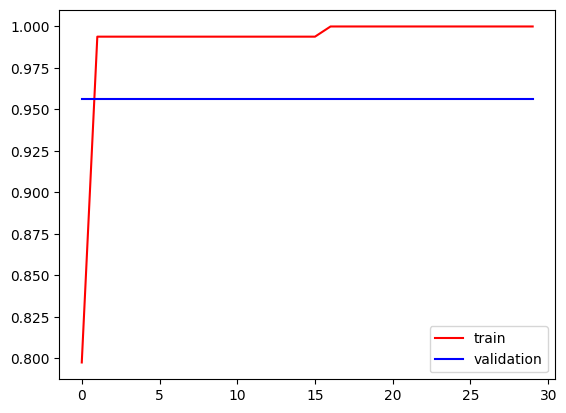

In [ ]:
import matplotlib.pyplot as plt
plt.plot(history.history['accuracy'],color='red',label='train')
plt.plot(history.history['val_accuracy'],color='blue',label='validation')
plt.legend()
plt.show()

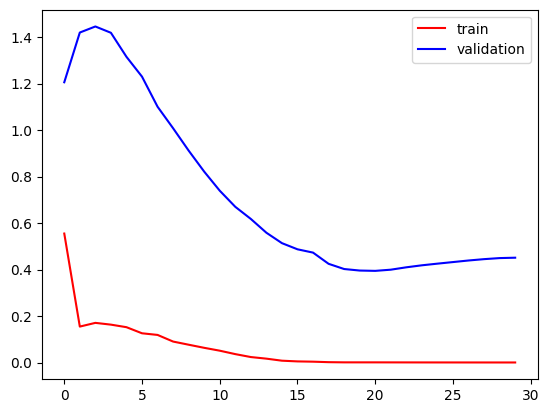

In [ ]:
import matplotlib.pyplot as plt
plt.plot(history.history['loss'],color='red',label='train')
plt.plot(history.history['val_loss'],color='blue',label='validation')
plt.legend()
plt.show()

(3000, 4000, 3)

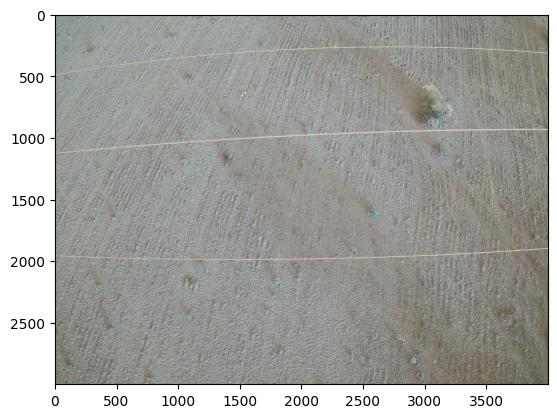

In [ ]:
import cv2
test_img=cv2.imread(r'/content/gdrive/MyDrive/dataset/Test/good dataset/DJI_0859.jpg')
plt.imshow(test_img)
test_img.shape


In [ ]:
import numpy as np
test_img=cv2.resize(test_img,(224,224))
test_img
img=np.expand_dims(test_img,axis=0)
img.shape

(1, 224, 224, 3)

In [ ]:
prediction=resnet_model.predict(img)
print(prediction)
prediction>0

1/1 [==============================] - 1s 1s/step
[[0.9998276]]


array([[ True]])

(3000, 4000, 3)

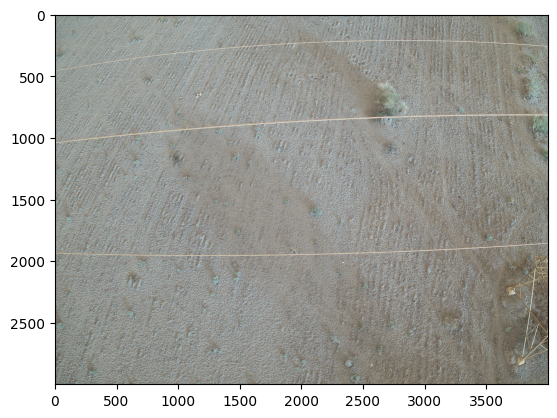

In [ ]:
import cv2
test_img1=cv2.imread(r'/content/gdrive/MyDrive/dataset/Test/good dataset/DJI_0861.jpg')
plt.imshow(test_img1)
test_img1.shape


In [ ]:
test_img1=cv2.resize(test_img1,(224,224))

img1=np.expand_dims(test_img1,axis=0)
img1.shape

(1, 224, 224, 3)

In [ ]:
prediction=resnet_model.predict(img1)
print(prediction)
prediction>0

1/1 [==============================] - 0s 26ms/step
[[0.9996588]]


array([[ True]])

(1, 224, 224, 3)
1/1 [==============================] - 0s 40ms/step
[[1.]]


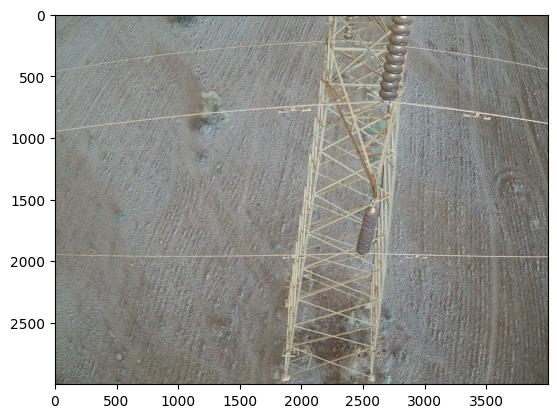

In [ ]:
import cv2
test_img3=cv2.imread(r'/content/gdrive/MyDrive/dataset/Test/good dataset/DJI_0869.jpg')
plt.imshow(test_img3)
test_img3=cv2.resize(test_img3,(224,224))
img4=np.expand_dims(test_img3,axis=0)
print(img4.shape)
prediction=resnet_model.predict(img4)
print(prediction)

(1, 224, 224, 3)
1/1 [==============================] - 0s 24ms/step
[[0.9999844]]


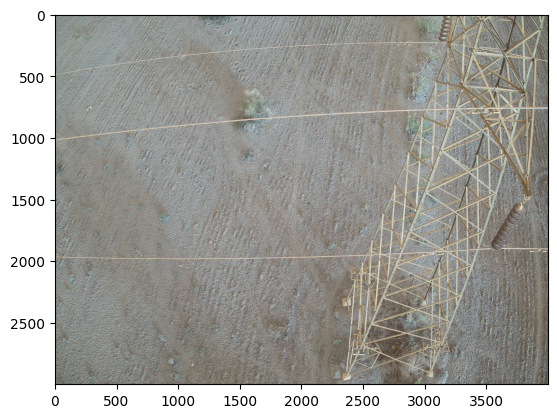

In [ ]:
import cv2
test_img4=cv2.imread(r'/content/gdrive/MyDrive/dataset/Test/good dataset/DJI_0867.jpg')
plt.imshow(test_img4)
test_img4=cv2.resize(test_img4,(224,224))
img4=np.expand_dims(test_img4,axis=0)
print(img4.shape)
prediction=resnet_model.predict(img4)
print(prediction)

(1, 224, 224, 3)
1/1 [==============================] - 0s 23ms/step
[[0.9998714]]


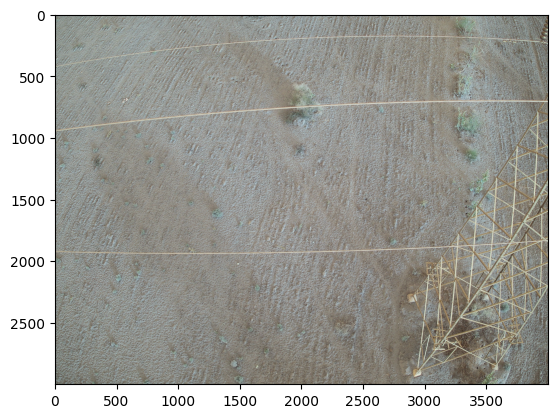

In [ ]:
import cv2
test_img5=cv2.imread(r'/content/gdrive/MyDrive/dataset/Test/good dataset/DJI_0863.jpg')
plt.imshow(test_img5)
test_img5=cv2.resize(test_img5,(224,224))
img4=np.expand_dims(test_img5,axis=0)
print(img4.shape)
prediction=resnet_model.predict(img4)
print(prediction)

1/1 [==============================] - 0s 28ms/step
[[0.99994457]]


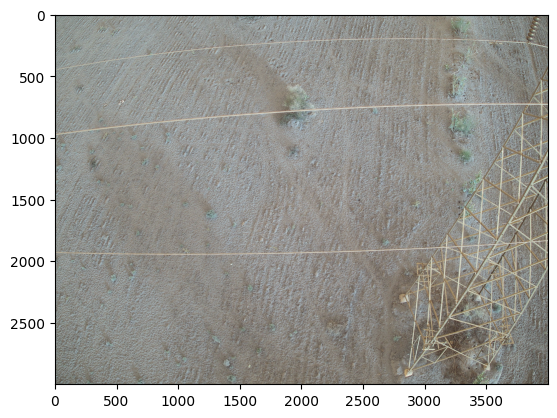

In [ ]:
import cv2
test_img6=cv2.imread(r'/content/gdrive/MyDrive/dataset/Test/good dataset/DJI_0865.jpg')
plt.imshow(test_img6)
test_img6=cv2.resize(test_img6,(224,224))
img4=np.expand_dims(test_img6,axis=0)
img4.shape
prediction=resnet_model.predict(img4)
print(prediction)

(1, 224, 224, 3)
1/1 [==============================] - 0s 42ms/step
[[1.]]


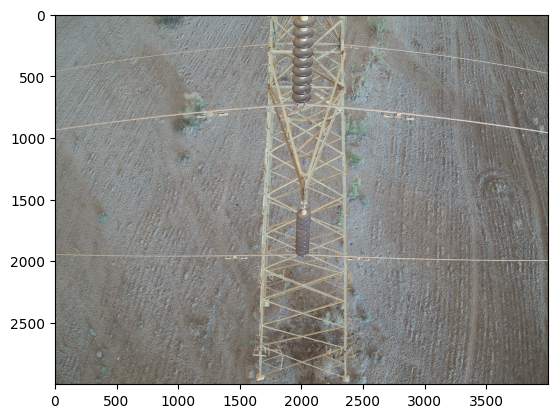

In [ ]:
import cv2
test_img7=cv2.imread(r'/content/gdrive/MyDrive/dataset/Test/good dataset/DJI_0871.jpg')
plt.imshow(test_img7)
test_img7=cv2.resize(test_img7,(224,224))
img4=np.expand_dims(test_img7,axis=0)
print(img4.shape)
prediction=resnet_model.predict(img4)
print(prediction)

(1, 224, 224, 3)
1/1 [==============================] - 0s 23ms/step
[[1.]]


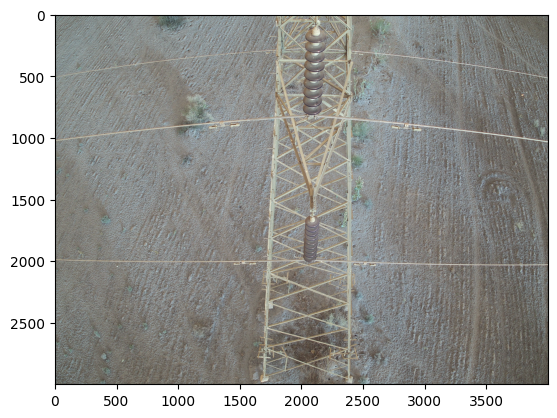

In [ ]:
import cv2
test_img7=cv2.imread(r'/content/gdrive/MyDrive/dataset/Test/good dataset/DJI_0873.jpg')
plt.imshow(test_img7)
test_img7=cv2.resize(test_img7,(224,224))
img4=np.expand_dims(test_img7,axis=0)
print(img4.shape)
prediction=resnet_model.predict(img4)
print(prediction)

(1, 224, 224, 3)
1/1 [==============================] - 0s 23ms/step
[[1.]]


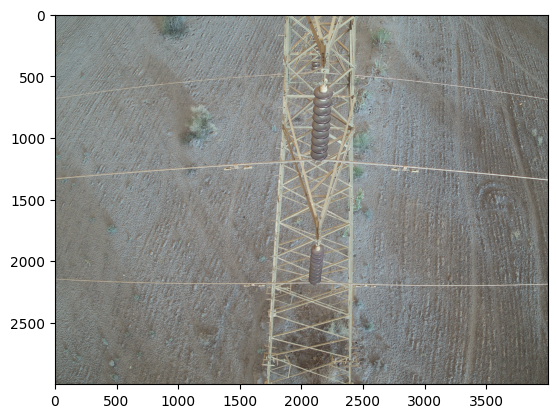

In [ ]:
import cv2
test_img8=cv2.imread(r'/content/gdrive/MyDrive/dataset/Test/good dataset/DJI_0875.jpg')
plt.imshow(test_img8)
test_img8=cv2.resize(test_img8,(224,224))
img4=np.expand_dims(test_img8,axis=0)
print(img4.shape)
prediction=resnet_model.predict(img4)
print(prediction)

(1, 224, 224, 3)
1/1 [==============================] - 0s 24ms/step
[[1.]]


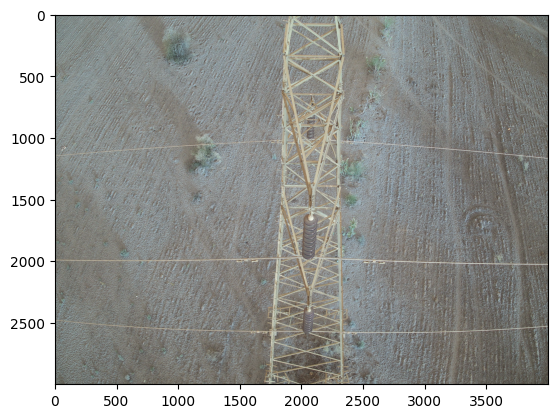

In [ ]:
import cv2
test_img9=cv2.imread(r'/content/gdrive/MyDrive/dataset/Test/good dataset/DJI_0877.jpg')
plt.imshow(test_img9)
test_img9=cv2.resize(test_img9,(224,224))
img4=np.expand_dims(test_img9,axis=0)
print(img4.shape)
prediction=resnet_model.predict(img4)
print(prediction)

(1, 224, 224, 3)
1/1 [==============================] - 0s 36ms/step
[[0.99999785]]


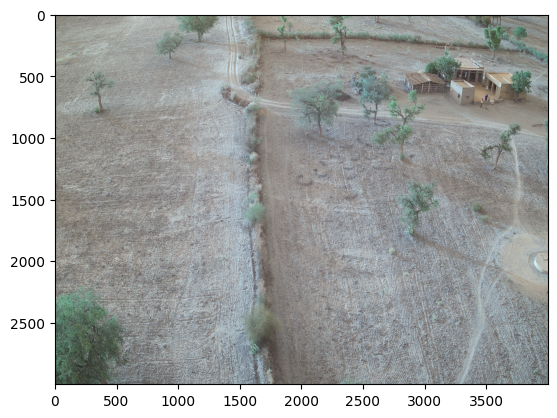

In [ ]:
import cv2
test_img9=cv2.imread(r'/content/gdrive/MyDrive/dataset/Test/bad dataset/DJI_0605.jpg')
plt.imshow(test_img9)
test_img9=cv2.resize(test_img9,(224,224))
img4=np.expand_dims(test_img9,axis=0)
print(img4.shape)
prediction=resnet_model.predict(img4)
print(prediction)

(1, 224, 224, 3)
1/1 [==============================] - 0s 37ms/step
[[0.9999893]]


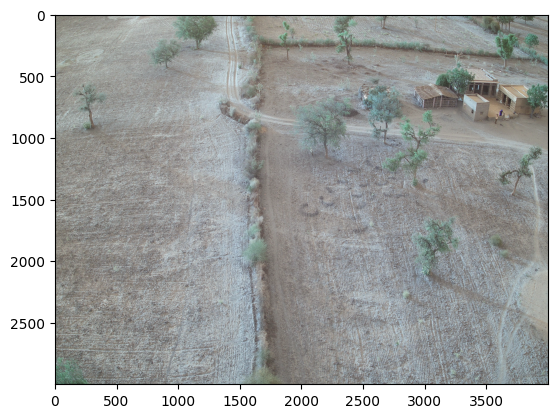

In [ ]:
import cv2
test_img9=cv2.imread(r'/content/gdrive/MyDrive/dataset/Test/bad dataset/DJI_0607.jpg')
plt.imshow(test_img9)
test_img9=cv2.resize(test_img9,(224,224))
img4=np.expand_dims(test_img9,axis=0)
print(img4.shape)
prediction=resnet_model.predict(img4)
print(prediction)

(1, 224, 224, 3)
1/1 [==============================] - 0s 35ms/step
[[0.9698995]]


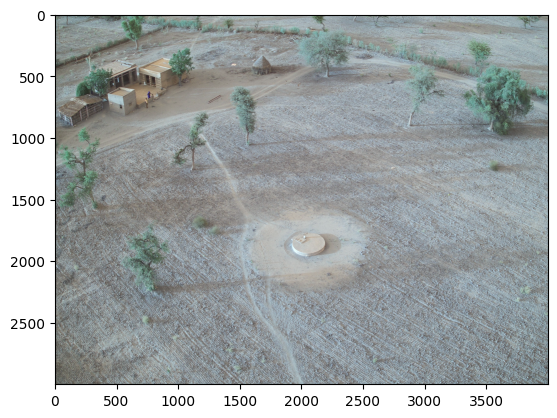

In [ ]:
import cv2
test_img9=cv2.imread(r'/content/gdrive/MyDrive/dataset/Test/bad dataset/DJI_0609.jpg')
plt.imshow(test_img9)
test_img9=cv2.resize(test_img9,(224,224))
img4=np.expand_dims(test_img9,axis=0)
print(img4.shape)
prediction=resnet_model.predict(img4)
print(prediction)

(1, 224, 224, 3)
1/1 [==============================] - 0s 34ms/step
[[1.]]


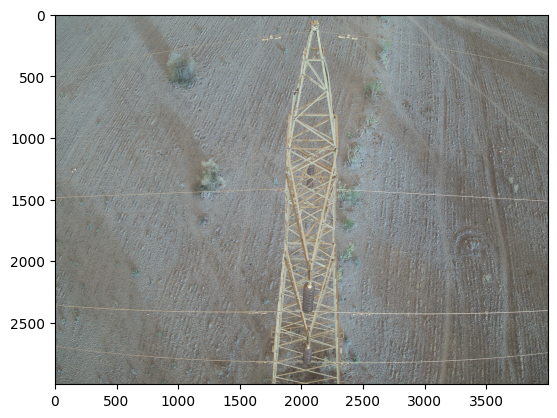

In [ ]:
import cv2
test_img9=cv2.imread(r'/content/gdrive/MyDrive/dataset/Test/good dataset/DJI_0879.jpg')
plt.imshow(test_img9)
test_img9=cv2.resize(test_img9,(224,224))
img4=np.expand_dims(test_img9,axis=0)
print(img4.shape)
prediction=resnet_model.predict(img4)
print(prediction)

(1, 224, 224, 3)
1/1 [==============================] - 0s 87ms/step
[[0.9999999]]


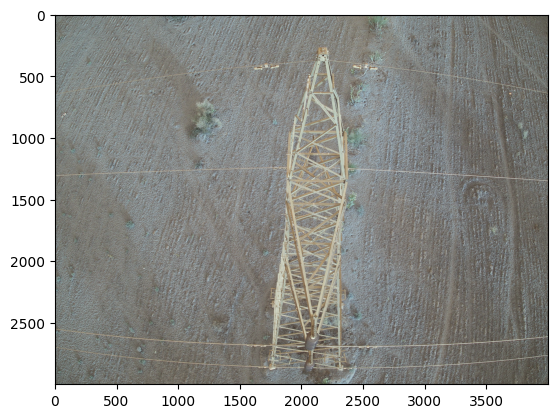

In [ ]:
import cv2
test_img9=cv2.imread(r'/content/gdrive/MyDrive/dataset/Test/good dataset/DJI_0881.jpg')
plt.imshow(test_img9)
test_img9=cv2.resize(test_img9,(224,224))
img4=np.expand_dims(test_img9,axis=0)
print(img4.shape)
prediction=resnet_model.predict(img4)
print(prediction)

(1, 224, 224, 3)
1/1 [==============================] - 0s 87ms/step
[[1.]]


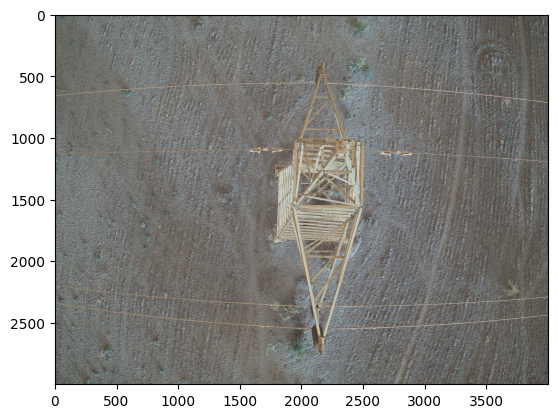

In [ ]:
import cv2
test_img9=cv2.imread(r'/content/gdrive/MyDrive/dataset/Test/good dataset/DJI_0883.jpg')
plt.imshow(test_img9)
test_img9=cv2.resize(test_img9,(224,224))
img4=np.expand_dims(test_img9,axis=0)
print(img4.shape)
prediction=resnet_model.predict(img4)
print(prediction)

(1, 224, 224, 3)
1/1 [==============================] - 0s 32ms/step
[[1.]]


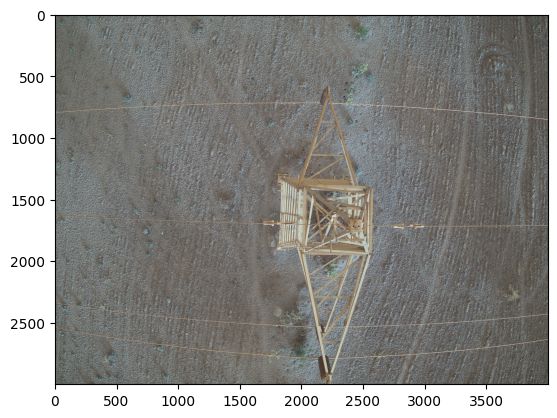

In [ ]:
import cv2
test_img9=cv2.imread(r'/content/gdrive/MyDrive/dataset/Test/good dataset/DJI_0885.jpg')
plt.imshow(test_img9)
test_img9=cv2.resize(test_img9,(224,224))
img4=np.expand_dims(test_img9,axis=0)
print(img4.shape)
prediction=resnet_model.predict(img4)
print(prediction)

(1, 224, 224, 3)
1/1 [==============================] - 0s 34ms/step
[[0.9999857]]


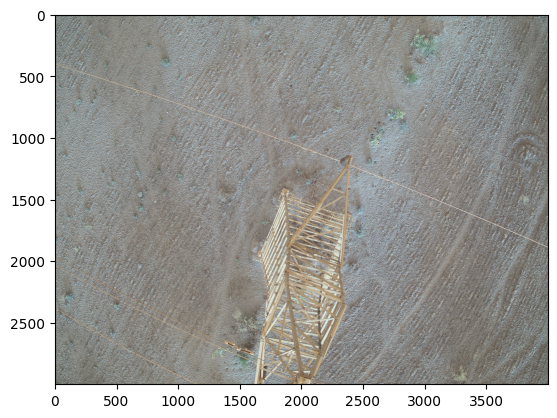

In [ ]:
import cv2
test_img9=cv2.imread(r'/content/gdrive/MyDrive/dataset/Test/good dataset/DJI_0887.jpg')
plt.imshow(test_img9)
test_img9=cv2.resize(test_img9,(224,224))
img4=np.expand_dims(test_img9,axis=0)
print(img4.shape)
prediction=resnet_model.predict(img4)
print(prediction)

(1, 224, 224, 3)
1/1 [==============================] - 0s 38ms/step
[[0.9999409]]


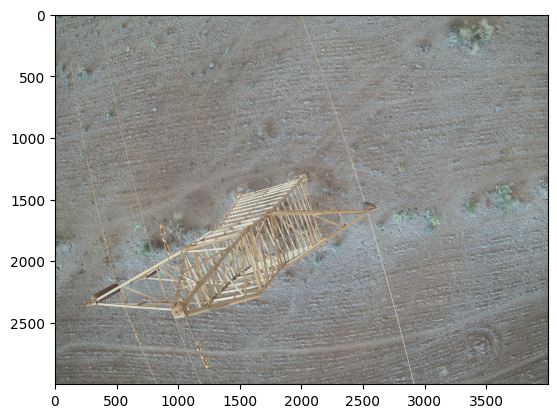

In [ ]:
import cv2
test_img9=cv2.imread(r'/content/gdrive/MyDrive/dataset/Test/good dataset/DJI_0889.jpg')
plt.imshow(test_img9)
test_img9=cv2.resize(test_img9,(224,224))
img4=np.expand_dims(test_img9,axis=0)
print(img4.shape)
prediction=resnet_model.predict(img4)
print(prediction)

(1, 224, 224, 3)
1/1 [==============================] - 0s 73ms/step
[[0.9999932]]


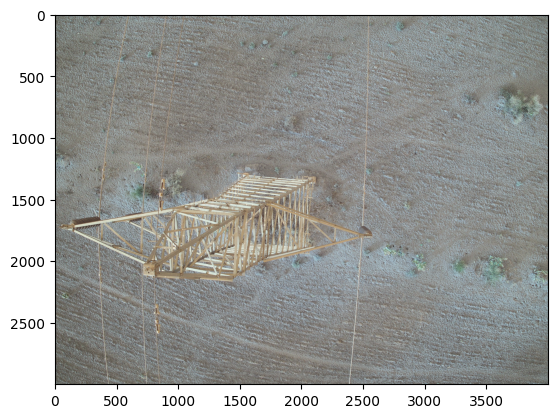

In [ ]:
import cv2
test_img9=cv2.imread(r'/content/gdrive/MyDrive/dataset/Test/good dataset/DJI_0891.jpg')
plt.imshow(test_img9)
test_img9=cv2.resize(test_img9,(224,224))
img4=np.expand_dims(test_img9,axis=0)
print(img4.shape)
prediction=resnet_model.predict(img4)
print(prediction)

(1, 224, 224, 3)
1/1 [==============================] - 0s 33ms/step
[[1.]]


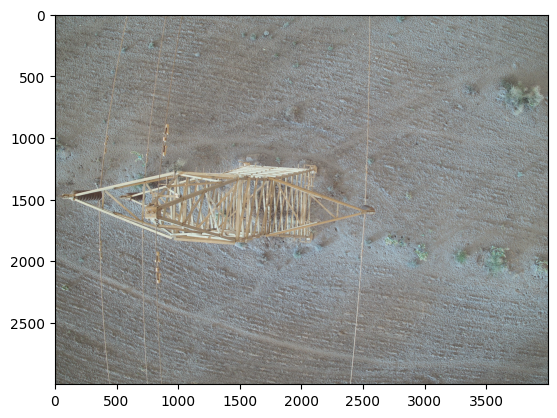

In [ ]:
import cv2
test_img9=cv2.imread(r'/content/gdrive/MyDrive/dataset/Test/good dataset/DJI_0893.jpg')
plt.imshow(test_img9)
test_img9=cv2.resize(test_img9,(224,224))
img4=np.expand_dims(test_img9,axis=0)
print(img4.shape)
prediction=resnet_model.predict(img4)
print(prediction)

(1, 224, 224, 3)
1/1 [==============================] - 0s 35ms/step
[[0.9999975]]


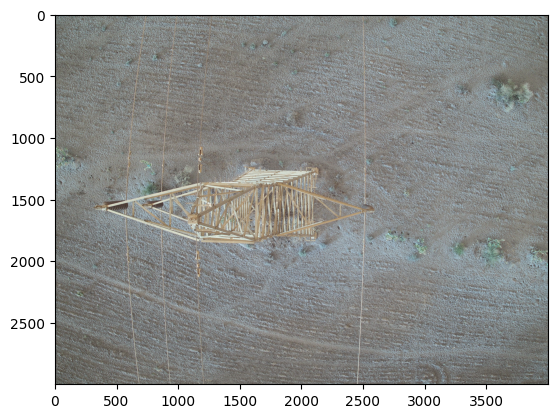

In [ ]:
import cv2
test_img9=cv2.imread(r'/content/gdrive/MyDrive/dataset/Test/good dataset/DJI_0895.jpg')
plt.imshow(test_img9)
test_img9=cv2.resize(test_img9,(224,224))
img4=np.expand_dims(test_img9,axis=0)
print(img4.shape)
prediction=resnet_model.predict(img4)
print(prediction)

(1, 224, 224, 3)
1/1 [==============================] - 0s 36ms/step
[[0.9999999]]


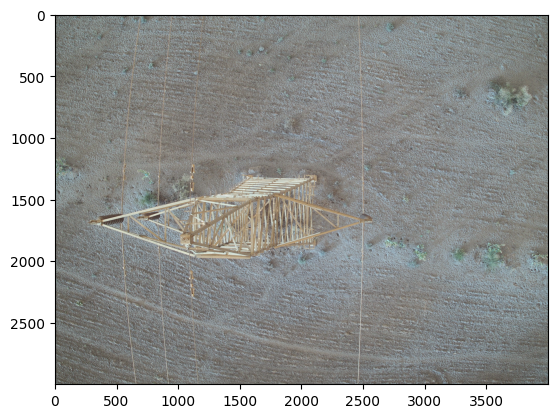

In [ ]:
import cv2
test_img9=cv2.imread(r'/content/gdrive/MyDrive/dataset/Test/good dataset/DJI_0897.jpg')
plt.imshow(test_img9)
test_img9=cv2.resize(test_img9,(224,224))
img4=np.expand_dims(test_img9,axis=0)
print(img4.shape)
prediction=resnet_model.predict(img4)
print(prediction)

(1, 224, 224, 3)
1/1 [==============================] - 0s 38ms/step
[[0.9999999]]


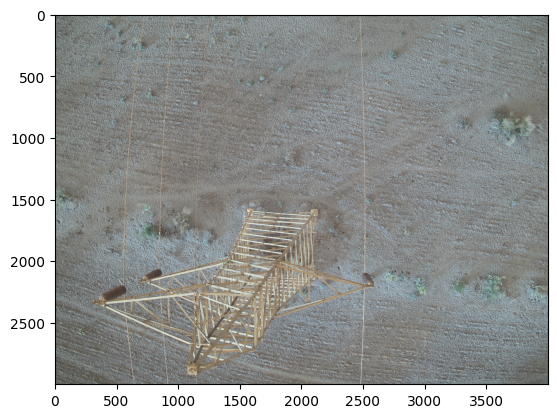

In [ ]:
import cv2
test_img9=cv2.imread(r'/content/gdrive/MyDrive/dataset/Test/good dataset/DJI_0899.jpg')
plt.imshow(test_img9)
test_img9=cv2.resize(test_img9,(224,224))
img4=np.expand_dims(test_img9,axis=0)
print(img4.shape)
prediction=resnet_model.predict(img4)
print(prediction)

(1, 224, 224, 3)
1/1 [==============================] - 0s 37ms/step
[[0.9999776]]


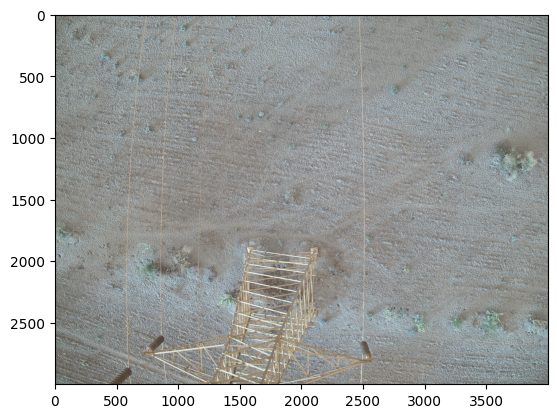

In [ ]:
import cv2
test_img9=cv2.imread(r'/content/gdrive/MyDrive/dataset/Test/good dataset/DJI_0901.jpg')
plt.imshow(test_img9)
test_img9=cv2.resize(test_img9,(224,224))
img4=np.expand_dims(test_img9,axis=0)
print(img4.shape)
prediction=resnet_model.predict(img4)
print(prediction)

(1, 224, 224, 3)
1/1 [==============================] - 0s 32ms/step
[[0.99996924]]


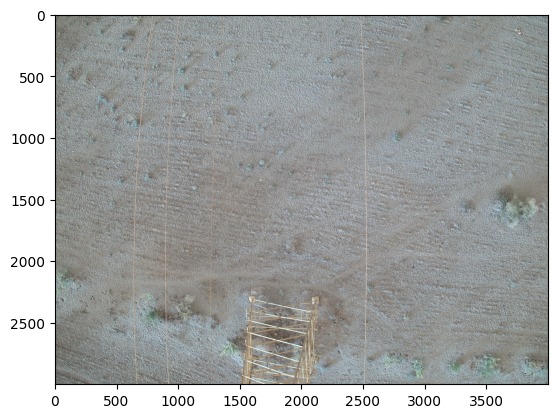

In [ ]:
import cv2
test_img9=cv2.imread(r'/content/gdrive/MyDrive/dataset/Test/good dataset/DJI_0903.jpg')
plt.imshow(test_img9)
test_img9=cv2.resize(test_img9,(224,224))
img4=np.expand_dims(test_img9,axis=0)
print(img4.shape)
prediction=resnet_model.predict(img4)
print(prediction)

(1, 224, 224, 3)
1/1 [==============================] - 0s 41ms/step
[[0.99924314]]


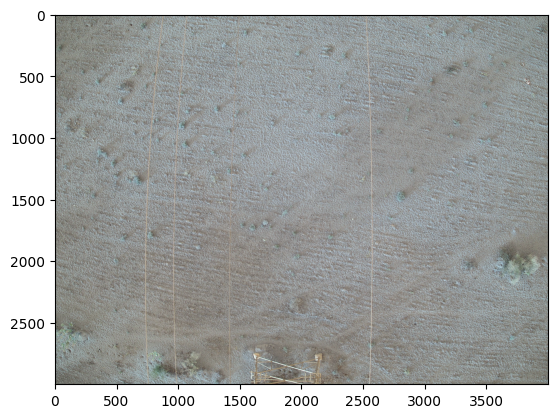

In [ ]:
import cv2
test_img9=cv2.imread(r'/content/gdrive/MyDrive/dataset/Test/good dataset/DJI_0905.jpg')
plt.imshow(test_img9)
test_img9=cv2.resize(test_img9,(224,224))
img4=np.expand_dims(test_img9,axis=0)
print(img4.shape)
prediction=resnet_model.predict(img4)
print(prediction)

(1, 224, 224, 3)
1/1 [==============================] - 0s 24ms/step
[[0.99894327]]


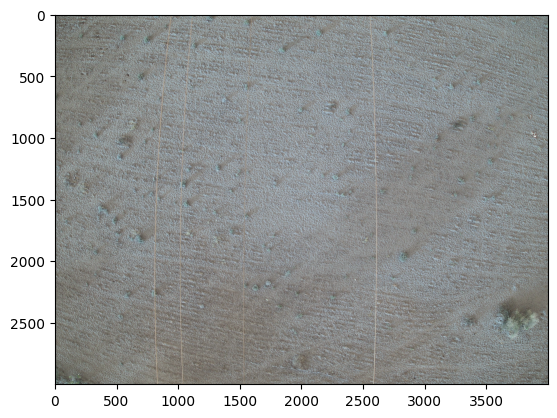

In [ ]:
import cv2
test_img9=cv2.imread(r'/content/gdrive/MyDrive/dataset/Test/good dataset/DJI_0907.jpg')
plt.imshow(test_img9)
test_img9=cv2.resize(test_img9,(224,224))
img4=np.expand_dims(test_img9,axis=0)
print(img4.shape)
prediction=resnet_model.predict(img4)
print(prediction)

(1, 224, 224, 3)
1/1 [==============================] - 0s 33ms/step
[[0.9995797]]


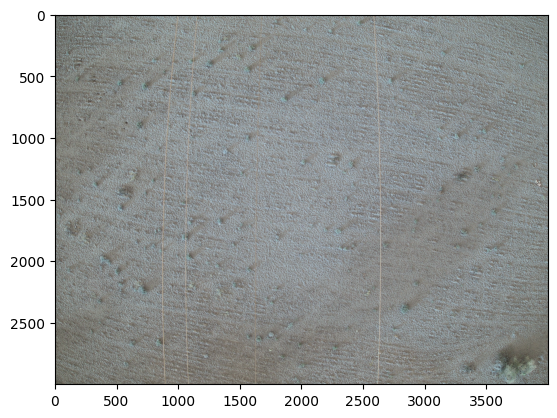

In [ ]:
import cv2
test_img9=cv2.imread(r'/content/gdrive/MyDrive/dataset/Test/good dataset/DJI_0909.jpg')
plt.imshow(test_img9)
test_img9=cv2.resize(test_img9,(224,224))
img4=np.expand_dims(test_img9,axis=0)
print(img4.shape)
prediction=resnet_model.predict(img4)
print(prediction)

(1, 224, 224, 3)
1/1 [==============================] - 0s 33ms/step
[[0.99990964]]


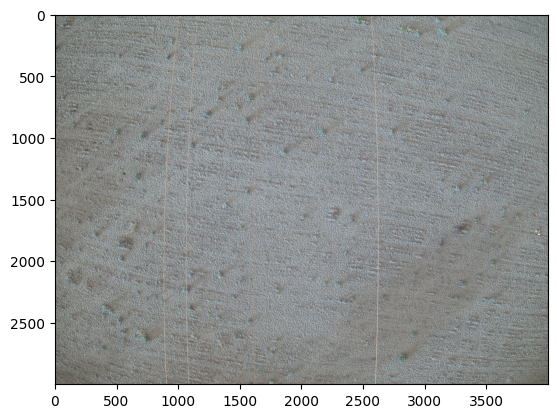

In [ ]:
import cv2
test_img9=cv2.imread(r'/content/gdrive/MyDrive/dataset/Test/good dataset/DJI_0911.jpg')
plt.imshow(test_img9)
test_img9=cv2.resize(test_img9,(224,224))
img4=np.expand_dims(test_img9,axis=0)
print(img4.shape)
prediction=resnet_model.predict(img4)
print(prediction)

(1, 224, 224, 3)
1/1 [==============================] - 0s 37ms/step
[[0.999728]]


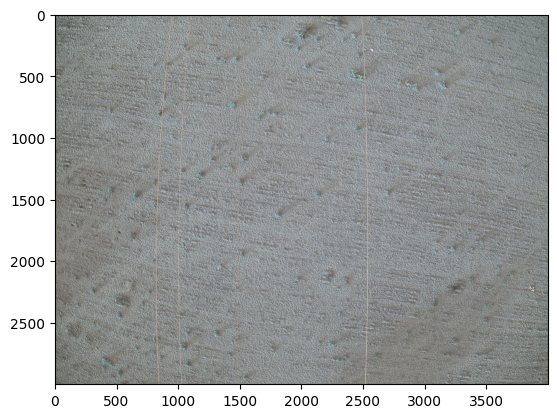

In [ ]:
import cv2
test_img9=cv2.imread(r'/content/gdrive/MyDrive/dataset/Test/good dataset/DJI_0913.jpg')
plt.imshow(test_img9)
test_img9=cv2.resize(test_img9,(224,224))
img4=np.expand_dims(test_img9,axis=0)
print(img4.shape)
prediction=resnet_model.predict(img4)
print(prediction)

(1, 224, 224, 3)
1/1 [==============================] - 0s 32ms/step
[[0.9994029]]


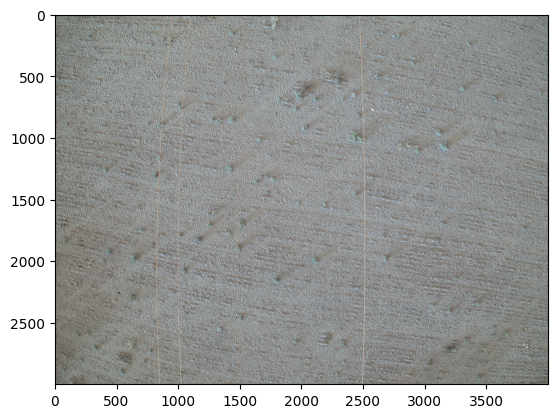

In [ ]:
import cv2
test_img9=cv2.imread(r'/content/gdrive/MyDrive/dataset/Test/good dataset/DJI_0915.jpg')
plt.imshow(test_img9)
test_img9=cv2.resize(test_img9,(224,224))
img4=np.expand_dims(test_img9,axis=0)
print(img4.shape)
prediction=resnet_model.predict(img4)
print(prediction)

(1, 224, 224, 3)
1/1 [==============================] - 0s 38ms/step
[[0.99897003]]


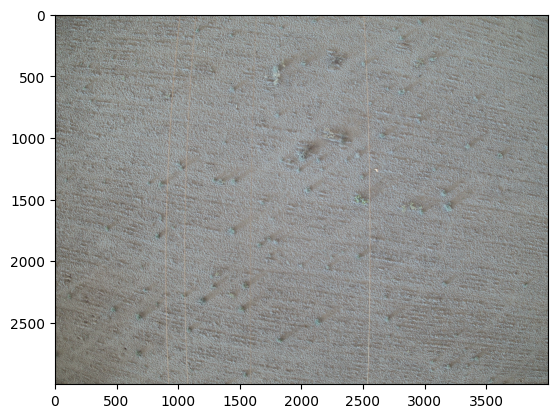

In [ ]:
import cv2
test_img9=cv2.imread(r'/content/gdrive/MyDrive/dataset/Test/good dataset/DJI_0917.jpg')
plt.imshow(test_img9)
test_img9=cv2.resize(test_img9,(224,224))
img4=np.expand_dims(test_img9,axis=0)
print(img4.shape)
prediction=resnet_model.predict(img4)
print(prediction)

(1, 224, 224, 3)
1/1 [==============================] - 0s 33ms/step
[[0.999102]]


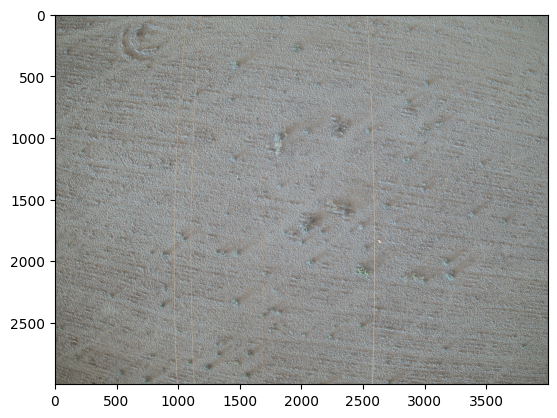

In [ ]:
import cv2
test_img9=cv2.imread(r'/content/gdrive/MyDrive/dataset/Test/good dataset/DJI_0919.jpg')
plt.imshow(test_img9)
test_img9=cv2.resize(test_img9,(224,224))
img4=np.expand_dims(test_img9,axis=0)
print(img4.shape)
prediction=resnet_model.predict(img4)
print(prediction)

(1, 224, 224, 3)
1/1 [==============================] - 0s 44ms/step
[[0.9993819]]


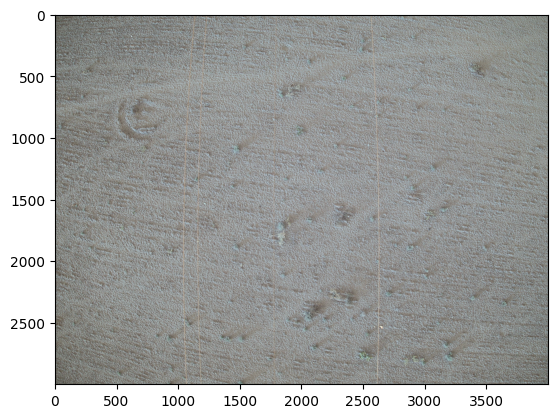

In [ ]:
import cv2
test_img9=cv2.imread(r'/content/gdrive/MyDrive/dataset/Test/good dataset/DJI_0921.jpg')
plt.imshow(test_img9)
test_img9=cv2.resize(test_img9,(224,224))
img4=np.expand_dims(test_img9,axis=0)
print(img4.shape)
prediction=resnet_model.predict(img4)
print(prediction)

(1, 224, 224, 3)
1/1 [==============================] - 0s 72ms/step
[[0.9986817]]


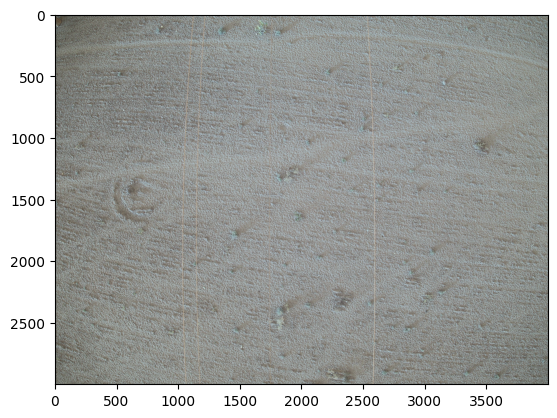

In [ ]:
import cv2
test_img9=cv2.imread(r'/content/gdrive/MyDrive/dataset/Test/good dataset/DJI_0923.jpg')
plt.imshow(test_img9)
test_img9=cv2.resize(test_img9,(224,224))
img4=np.expand_dims(test_img9,axis=0)
print(img4.shape)
prediction=resnet_model.predict(img4)
print(prediction)

(1, 224, 224, 3)
1/1 [==============================] - 0s 36ms/step
[[0.9993748]]


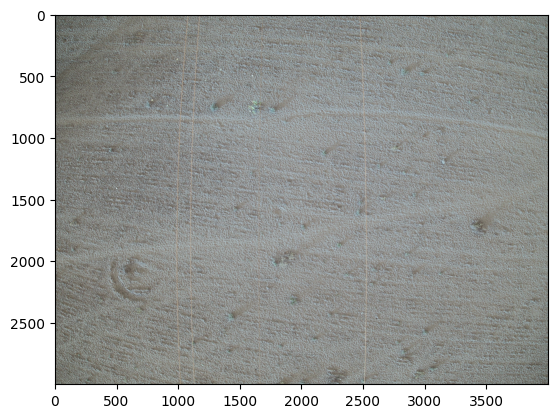

In [ ]:
import cv2
test_img9=cv2.imread(r'/content/gdrive/MyDrive/dataset/Test/good dataset/DJI_0925.jpg')
plt.imshow(test_img9)
test_img9=cv2.resize(test_img9,(224,224))
img4=np.expand_dims(test_img9,axis=0)
print(img4.shape)
prediction=resnet_model.predict(img4)
print(prediction)

(1, 224, 224, 3)
1/1 [==============================] - 0s 65ms/step
[[0.9989114]]


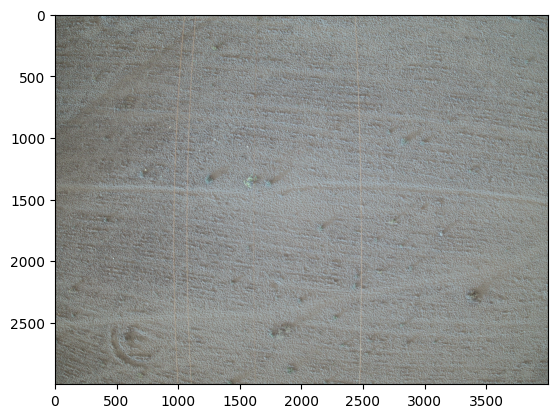

In [ ]:
import cv2
test_img9=cv2.imread(r'/content/gdrive/MyDrive/dataset/Test/good dataset/DJI_0927.jpg')
plt.imshow(test_img9)
test_img9=cv2.resize(test_img9,(224,224))
img4=np.expand_dims(test_img9,axis=0)
print(img4.shape)
prediction=resnet_model.predict(img4)
print(prediction)

(1, 224, 224, 3)
1/1 [==============================] - 0s 33ms/step
[[0.9998084]]


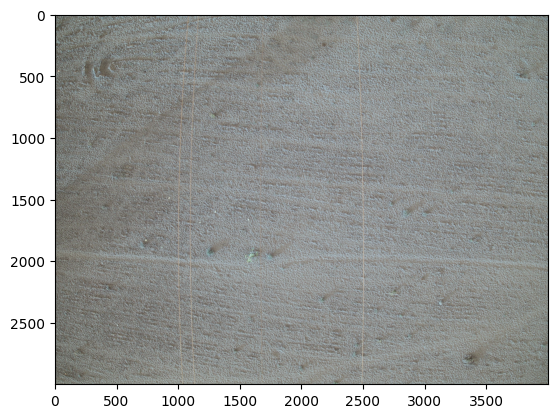

In [ ]:
import cv2
test_img9=cv2.imread(r'/content/gdrive/MyDrive/dataset/Test/good dataset/DJI_0929.jpg')
plt.imshow(test_img9)
test_img9=cv2.resize(test_img9,(224,224))
img4=np.expand_dims(test_img9,axis=0)
print(img4.shape)
prediction=resnet_model.predict(img4)
print(prediction)

(1, 224, 224, 3)
1/1 [==============================] - 0s 35ms/step
[[0.9993432]]


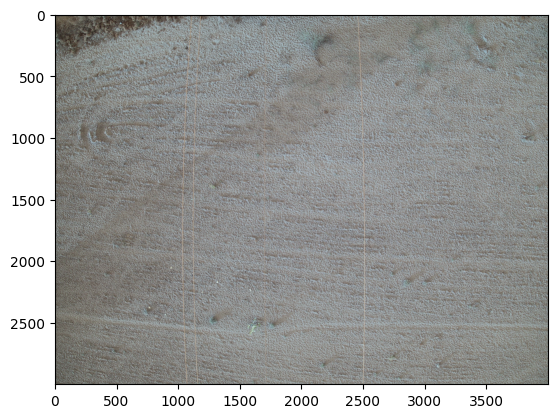

In [ ]:
import cv2
test_img9=cv2.imread(r'/content/gdrive/MyDrive/dataset/Test/good dataset/DJI_0931.jpg')
plt.imshow(test_img9)
test_img9=cv2.resize(test_img9,(224,224))
img4=np.expand_dims(test_img9,axis=0)
print(img4.shape)
prediction=resnet_model.predict(img4)
print(prediction)

(1, 224, 224, 3)
1/1 [==============================] - 0s 38ms/step
[[0.99952793]]


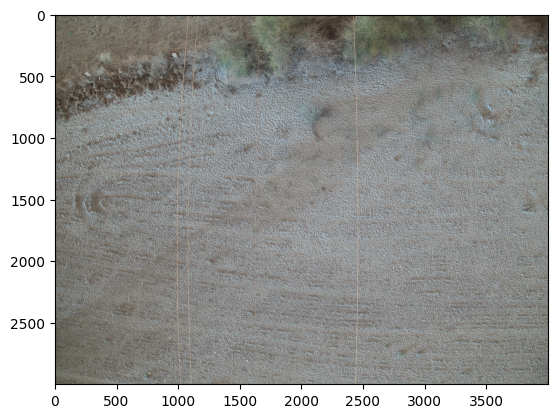

In [ ]:
import cv2
test_img9=cv2.imread(r'/content/gdrive/MyDrive/dataset/Test/good dataset/DJI_0933.jpg')
plt.imshow(test_img9)
test_img9=cv2.resize(test_img9,(224,224))
img4=np.expand_dims(test_img9,axis=0)
print(img4.shape)
prediction=resnet_model.predict(img4)
print(prediction)

(1, 224, 224, 3)
1/1 [==============================] - 0s 37ms/step
[[0.9972583]]


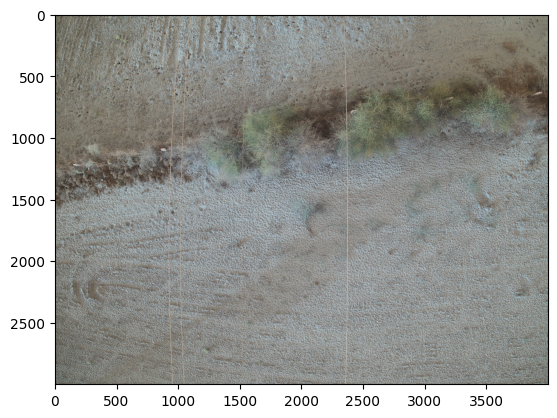

In [ ]:
import cv2
test_img9=cv2.imread(r'/content/gdrive/MyDrive/dataset/Test/good dataset/DJI_0935.jpg')
plt.imshow(test_img9)
test_img9=cv2.resize(test_img9,(224,224))
img4=np.expand_dims(test_img9,axis=0)
print(img4.shape)
prediction=resnet_model.predict(img4)
print(prediction)

(1, 224, 224, 3)
1/1 [==============================] - 0s 33ms/step
[[0.999416]]


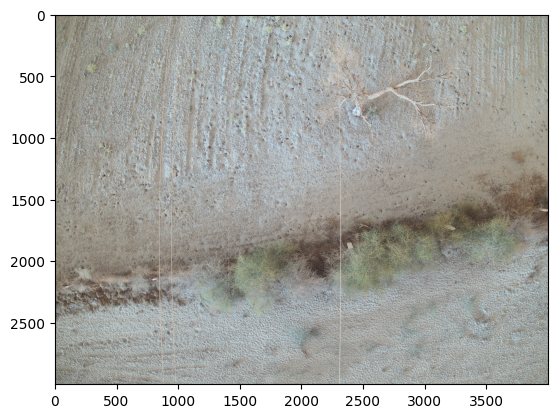

In [ ]:
import cv2
test_img9=cv2.imread(r'/content/gdrive/MyDrive/dataset/Test/good dataset/DJI_0937.jpg')
plt.imshow(test_img9)
test_img9=cv2.resize(test_img9,(224,224))
img4=np.expand_dims(test_img9,axis=0)
print(img4.shape)
prediction=resnet_model.predict(img4)
print(prediction)

(1, 224, 224, 3)
1/1 [==============================] - 0s 34ms/step
[[0.9999548]]


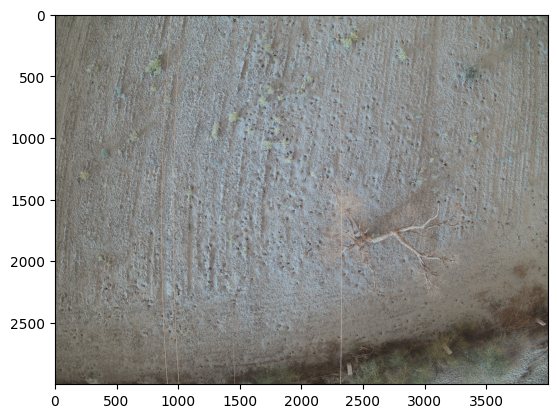

In [ ]:
import cv2
test_img9=cv2.imread(r'/content/gdrive/MyDrive/dataset/Test/good dataset/DJI_0939.jpg')
plt.imshow(test_img9)
test_img9=cv2.resize(test_img9,(224,224))
img4=np.expand_dims(test_img9,axis=0)
print(img4.shape)
prediction=resnet_model.predict(img4)
print(prediction)

(1, 224, 224, 3)
1/1 [==============================] - 0s 32ms/step
[[0.9999939]]


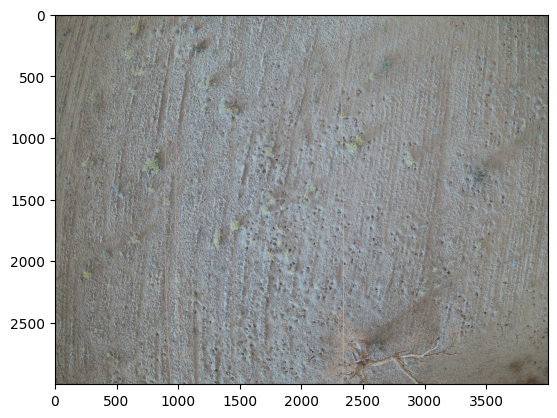

In [ ]:
import cv2
test_img9=cv2.imread(r'/content/gdrive/MyDrive/dataset/Test/good dataset/DJI_0941.jpg')
plt.imshow(test_img9)
test_img9=cv2.resize(test_img9,(224,224))
img4=np.expand_dims(test_img9,axis=0)
print(img4.shape)
prediction=resnet_model.predict(img4)
print(prediction)

(1, 224, 224, 3)
1/1 [==============================] - 0s 37ms/step
[[0.99997425]]


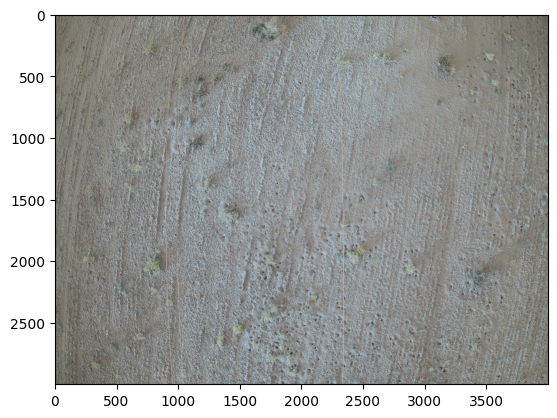

In [ ]:
import cv2
test_img9=cv2.imread(r'/content/gdrive/MyDrive/dataset/Test/good dataset/DJI_0943.jpg')
plt.imshow(test_img9)
test_img9=cv2.resize(test_img9,(224,224))
img4=np.expand_dims(test_img9,axis=0)
print(img4.shape)
prediction=resnet_model.predict(img4)
print(prediction)

(1, 224, 224, 3)
1/1 [==============================] - 0s 37ms/step
[[0.99996924]]


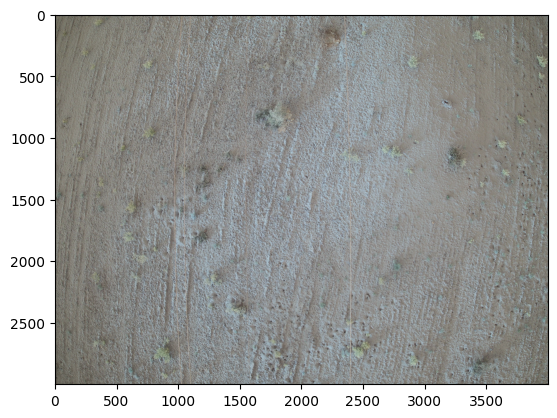

In [ ]:
import cv2
test_img9=cv2.imread(r'/content/gdrive/MyDrive/dataset/Test/good dataset/DJI_0945.jpg')
plt.imshow(test_img9)
test_img9=cv2.resize(test_img9,(224,224))
img4=np.expand_dims(test_img9,axis=0)
print(img4.shape)
prediction=resnet_model.predict(img4)
print(prediction)

(1, 224, 224, 3)
1/1 [==============================] - 0s 38ms/step
[[0.99998283]]


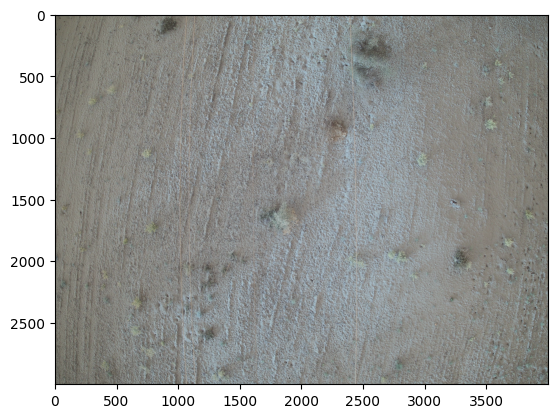

In [ ]:
import cv2
test_img9=cv2.imread(r'/content/gdrive/MyDrive/dataset/Test/good dataset/DJI_0947.jpg')
plt.imshow(test_img9)
test_img9=cv2.resize(test_img9,(224,224))
img4=np.expand_dims(test_img9,axis=0)
print(img4.shape)
prediction=resnet_model.predict(img4)
print(prediction)

(1, 224, 224, 3)
1/1 [==============================] - 0s 32ms/step
[[0.9998394]]


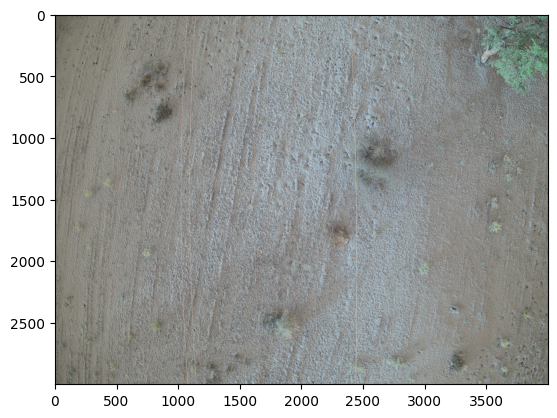

In [ ]:
import cv2
test_img9=cv2.imread(r'/content/gdrive/MyDrive/dataset/Test/good dataset/DJI_0949.jpg')
plt.imshow(test_img9)
test_img9=cv2.resize(test_img9,(224,224))
img4=np.expand_dims(test_img9,axis=0)
print(img4.shape)
prediction=resnet_model.predict(img4)
print(prediction)

(1, 224, 224, 3)
1/1 [==============================] - 0s 34ms/step
[[0.99996054]]


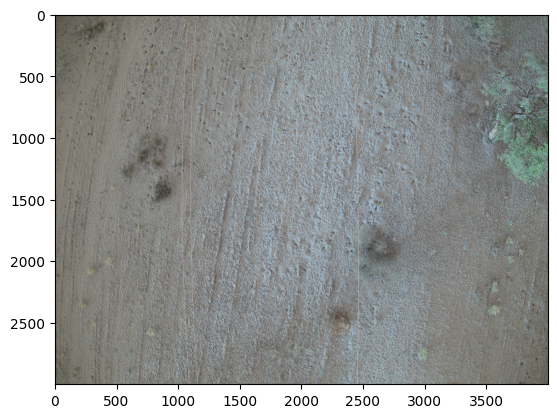

In [ ]:
import cv2
test_img9=cv2.imread(r'/content/gdrive/MyDrive/dataset/Test/good dataset/DJI_0951.jpg')
plt.imshow(test_img9)
test_img9=cv2.resize(test_img9,(224,224))
img4=np.expand_dims(test_img9,axis=0)
print(img4.shape)
prediction=resnet_model.predict(img4)
print(prediction)

(1, 224, 224, 3)
1/1 [==============================] - 0s 71ms/step
[[0.9999738]]


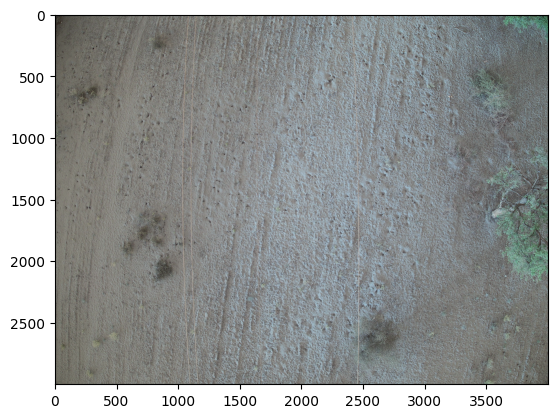

In [ ]:
import cv2
test_img9=cv2.imread(r'/content/gdrive/MyDrive/dataset/Test/good dataset/DJI_0953.jpg')
plt.imshow(test_img9)
test_img9=cv2.resize(test_img9,(224,224))
img4=np.expand_dims(test_img9,axis=0)
print(img4.shape)
prediction=resnet_model.predict(img4)
print(prediction)

(1, 224, 224, 3)
1/1 [==============================] - 0s 64ms/step
[[0.9999896]]


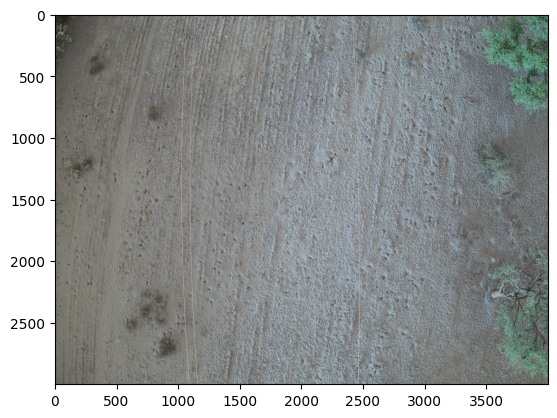

In [ ]:
import cv2
test_img9=cv2.imread(r'/content/gdrive/MyDrive/dataset/Test/good dataset/DJI_0955.jpg')
plt.imshow(test_img9)
test_img9=cv2.resize(test_img9,(224,224))
img4=np.expand_dims(test_img9,axis=0)
print(img4.shape)
prediction=resnet_model.predict(img4)
print(prediction)

(1, 224, 224, 3)
1/1 [==============================] - 0s 32ms/step
[[0.99999917]]


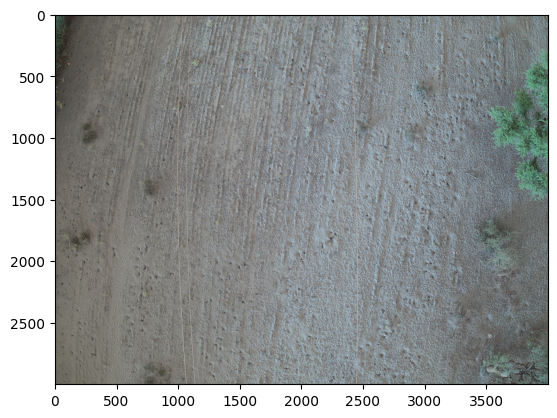

In [ ]:
import cv2
test_img9=cv2.imread(r'/content/gdrive/MyDrive/dataset/Test/good dataset/DJI_0957.jpg')
plt.imshow(test_img9)
test_img9=cv2.resize(test_img9,(224,224))
img4=np.expand_dims(test_img9,axis=0)
print(img4.shape)
prediction=resnet_model.predict(img4)
print(prediction)

(1, 224, 224, 3)
1/1 [==============================] - 0s 42ms/step
[[0.99999845]]


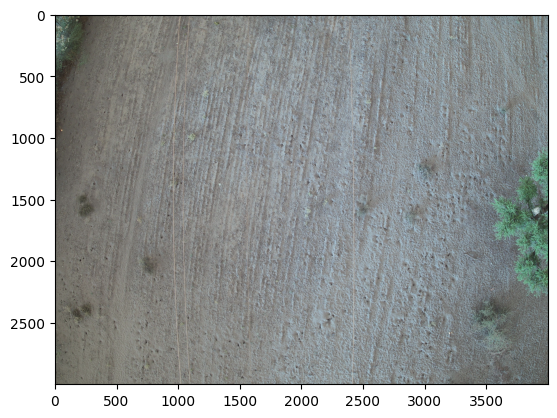

In [ ]:
import cv2
test_img9=cv2.imread(r'/content/gdrive/MyDrive/dataset/Test/good dataset/DJI_0959.jpg')
plt.imshow(test_img9)
test_img9=cv2.resize(test_img9,(224,224))
img4=np.expand_dims(test_img9,axis=0)
print(img4.shape)
prediction=resnet_model.predict(img4)
print(prediction)

(1, 224, 224, 3)
1/1 [==============================] - 0s 33ms/step
[[0.9999975]]


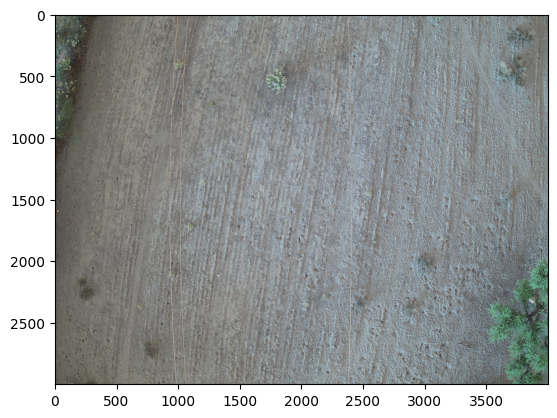

In [ ]:
import cv2
test_img9=cv2.imread(r'/content/gdrive/MyDrive/dataset/Test/good dataset/DJI_0961.jpg')
plt.imshow(test_img9)
test_img9=cv2.resize(test_img9,(224,224))
img4=np.expand_dims(test_img9,axis=0)
print(img4.shape)
prediction=resnet_model.predict(img4)
print(prediction)

(1, 224, 224, 3)
1/1 [==============================] - 0s 25ms/step
[[0.9999989]]


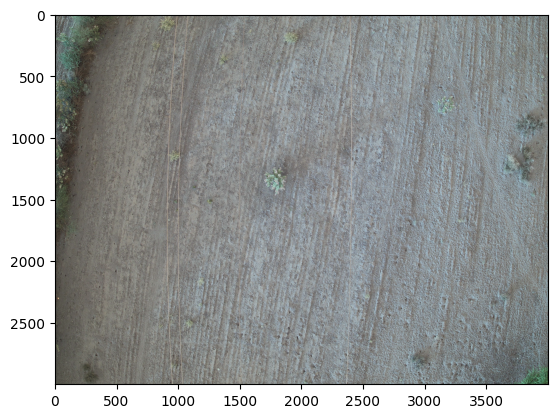

In [ ]:
import cv2
test_img9=cv2.imread(r'/content/gdrive/MyDrive/dataset/Test/good dataset/DJI_0963.jpg')
plt.imshow(test_img9)
test_img9=cv2.resize(test_img9,(224,224))
img4=np.expand_dims(test_img9,axis=0)
print(img4.shape)
prediction=resnet_model.predict(img4)
print(prediction)

(1, 224, 224, 3)
1/1 [==============================] - 0s 37ms/step
[[0.99999714]]


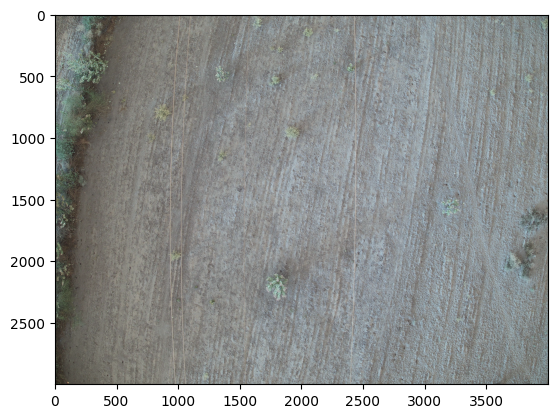

In [ ]:
import cv2
test_img9=cv2.imread(r'/content/gdrive/MyDrive/dataset/Test/good dataset/DJI_0965.jpg')
plt.imshow(test_img9)
test_img9=cv2.resize(test_img9,(224,224))
img4=np.expand_dims(test_img9,axis=0)
print(img4.shape)
prediction=resnet_model.predict(img4)
print(prediction)

(1, 224, 224, 3)
1/1 [==============================] - 0s 36ms/step
[[0.9999994]]


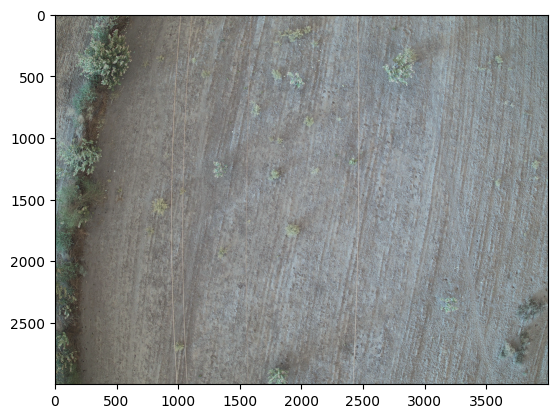

In [ ]:
import cv2
test_img9=cv2.imread(r'/content/gdrive/MyDrive/dataset/Test/good dataset/DJI_0967.jpg')
plt.imshow(test_img9)
test_img9=cv2.resize(test_img9,(224,224))
img4=np.expand_dims(test_img9,axis=0)
print(img4.shape)
prediction=resnet_model.predict(img4)
print(prediction)

(1, 224, 224, 3)
1/1 [==============================] - 0s 78ms/step
[[0.9999982]]


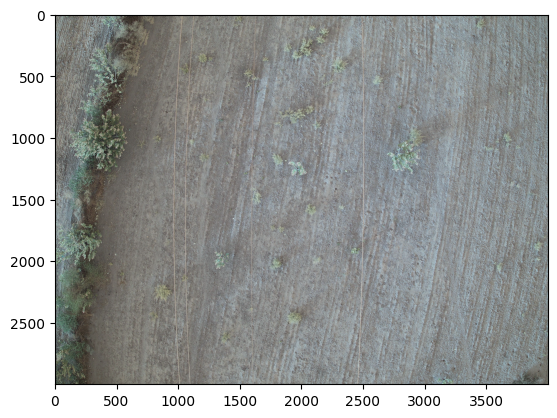

In [ ]:
import cv2
test_img9=cv2.imread(r'/content/gdrive/MyDrive/dataset/Test/good dataset/DJI_0969.jpg')
plt.imshow(test_img9)
test_img9=cv2.resize(test_img9,(224,224))
img4=np.expand_dims(test_img9,axis=0)
print(img4.shape)
prediction=resnet_model.predict(img4)
print(prediction)

(1, 224, 224, 3)
1/1 [==============================] - 0s 33ms/step
[[0.9999999]]


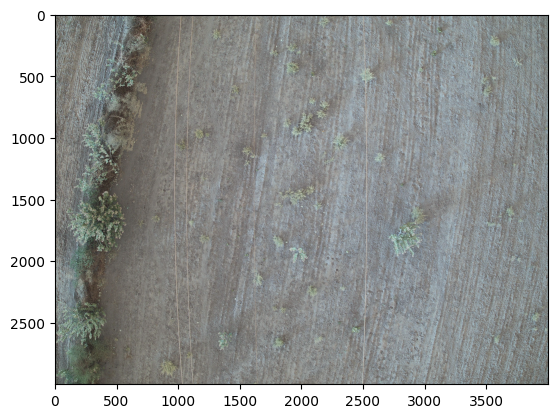

In [ ]:
import cv2
test_img9=cv2.imread(r'/content/gdrive/MyDrive/dataset/Test/good dataset/DJI_0971.jpg')
plt.imshow(test_img9)
test_img9=cv2.resize(test_img9,(224,224))
img4=np.expand_dims(test_img9,axis=0)
print(img4.shape)
prediction=resnet_model.predict(img4)
print(prediction)

(1, 224, 224, 3)
1/1 [==============================] - 0s 72ms/step
[[1.]]


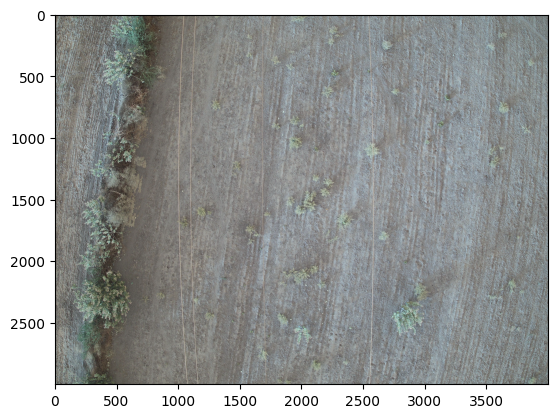

In [ ]:
import cv2
test_img9=cv2.imread(r'/content/gdrive/MyDrive/dataset/Test/good dataset/DJI_0973.jpg')
plt.imshow(test_img9)
test_img9=cv2.resize(test_img9,(224,224))
img4=np.expand_dims(test_img9,axis=0)
print(img4.shape)
prediction=resnet_model.predict(img4)
print(prediction)

(1, 224, 224, 3)
1/1 [==============================] - 0s 68ms/step
[[0.99999905]]


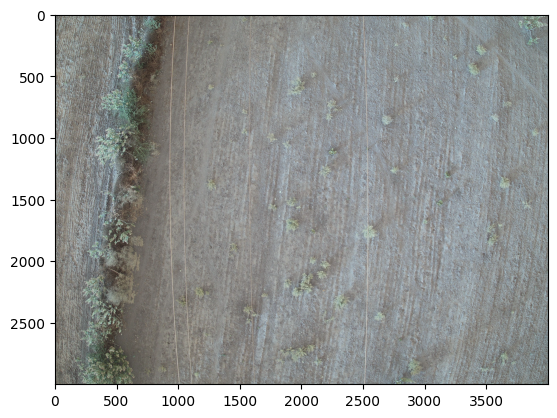

In [ ]:
import cv2
test_img9=cv2.imread(r'/content/gdrive/MyDrive/dataset/Test/good dataset/DJI_0975.jpg')
plt.imshow(test_img9)
test_img9=cv2.resize(test_img9,(224,224))
img4=np.expand_dims(test_img9,axis=0)
print(img4.shape)
prediction=resnet_model.predict(img4)
print(prediction)

(1, 224, 224, 3)
1/1 [==============================] - 0s 33ms/step
[[0.9999995]]


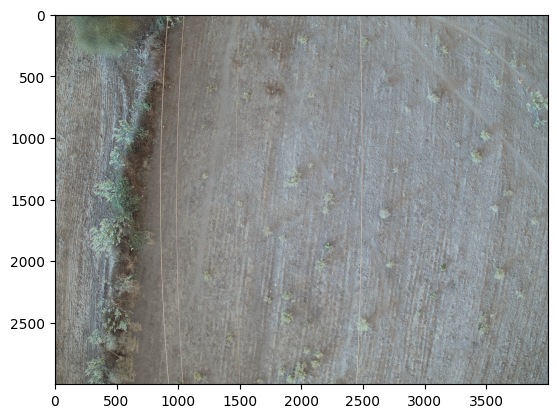

In [ ]:
import cv2
test_img9=cv2.imread(r'/content/gdrive/MyDrive/dataset/Test/good dataset/DJI_0977.jpg')
plt.imshow(test_img9)
test_img9=cv2.resize(test_img9,(224,224))
img4=np.expand_dims(test_img9,axis=0)
print(img4.shape)
prediction=resnet_model.predict(img4)
print(prediction)

(1, 224, 224, 3)
1/1 [==============================] - 0s 79ms/step
[[0.9999987]]


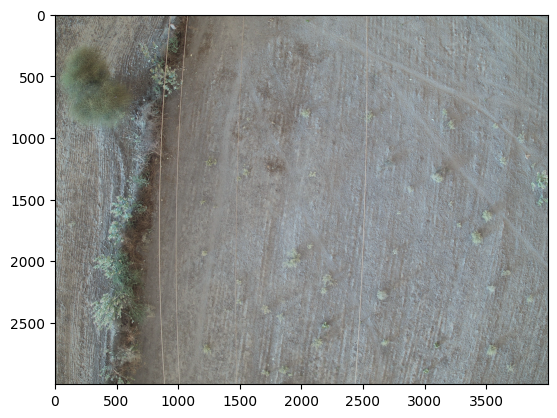

In [ ]:
import cv2
test_img9=cv2.imread(r'/content/gdrive/MyDrive/dataset/Test/good dataset/DJI_0979.jpg')
plt.imshow(test_img9)
test_img9=cv2.resize(test_img9,(224,224))
img4=np.expand_dims(test_img9,axis=0)
print(img4.shape)
prediction=resnet_model.predict(img4)
print(prediction)

(1, 224, 224, 3)
1/1 [==============================] - 0s 33ms/step
[[0.9999987]]


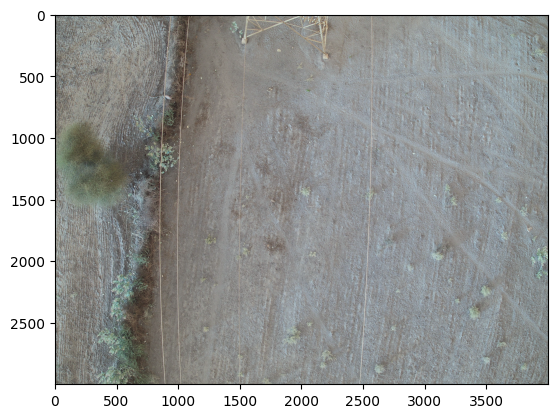

In [ ]:
import cv2
test_img9=cv2.imread(r'/content/gdrive/MyDrive/dataset/Test/good dataset/DJI_0981.jpg')
plt.imshow(test_img9)
test_img9=cv2.resize(test_img9,(224,224))
img4=np.expand_dims(test_img9,axis=0)
print(img4.shape)
prediction=resnet_model.predict(img4)
print(prediction)

(1, 224, 224, 3)
1/1 [==============================] - 0s 33ms/step
[[0.99999917]]


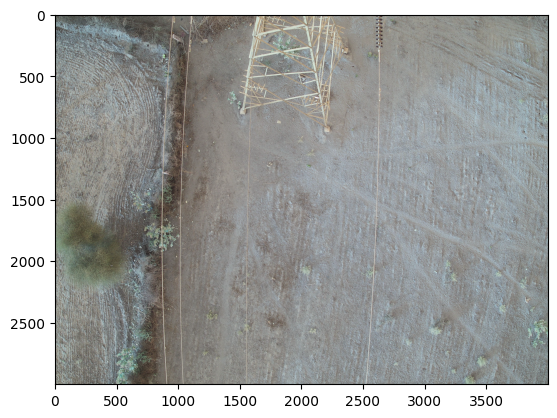

In [ ]:
import cv2
test_img9=cv2.imread(r'/content/gdrive/MyDrive/dataset/Test/good dataset/DJI_0983.jpg')
plt.imshow(test_img9)
test_img9=cv2.resize(test_img9,(224,224))
img4=np.expand_dims(test_img9,axis=0)
print(img4.shape)
prediction=resnet_model.predict(img4)
print(prediction)

(1, 224, 224, 3)
1/1 [==============================] - 0s 34ms/step
[[0.9999999]]


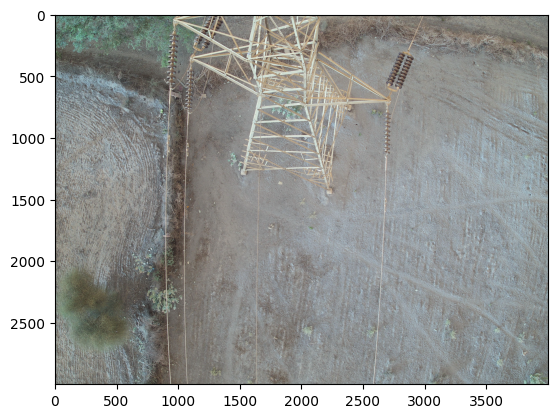

In [ ]:
import cv2
test_img9=cv2.imread(r'/content/gdrive/MyDrive/dataset/Test/good dataset/DJI_0985.jpg')
plt.imshow(test_img9)
test_img9=cv2.resize(test_img9,(224,224))
img4=np.expand_dims(test_img9,axis=0)
print(img4.shape)
prediction=resnet_model.predict(img4)
print(prediction)

(1, 224, 224, 3)
1/1 [==============================] - 0s 36ms/step
[[1.]]


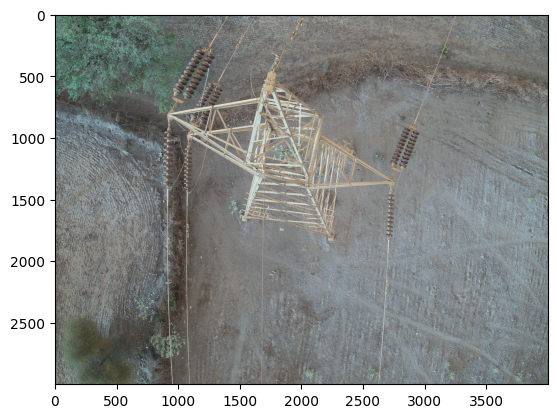

In [ ]:
import cv2
test_img9=cv2.imread(r'/content/gdrive/MyDrive/dataset/Test/good dataset/DJI_0987.jpg')
plt.imshow(test_img9)
test_img9=cv2.resize(test_img9,(224,224))
img4=np.expand_dims(test_img9,axis=0)
print(img4.shape)
prediction=resnet_model.predict(img4)
print(prediction)

(1, 224, 224, 3)
1/1 [==============================] - 0s 31ms/step
[[1.]]


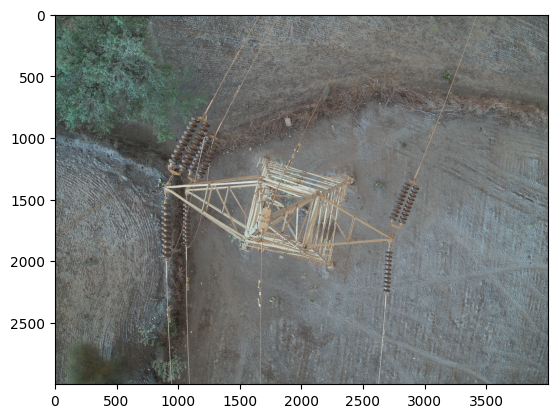

In [ ]:
import cv2
test_img9=cv2.imread(r'/content/gdrive/MyDrive/dataset/Test/good dataset/DJI_0989.jpg')
plt.imshow(test_img9)
test_img9=cv2.resize(test_img9,(224,224))
img4=np.expand_dims(test_img9,axis=0)
print(img4.shape)
prediction=resnet_model.predict(img4)
print(prediction)

In [ ]:

from sklearn.metrics import classification_report,confusion_matrix
truth=['good ','good ','good ','good ','good ','good ','good ','good ','good ','good ','bad ','bad ','bad ','good ','good ','good ','good ','good ','good ','good ','good ','good ','good ','good ','good ','good ','good ','good ','good ','good ','good ','good ','good ','good ','good ','good ','good ','good ','good ','good ','good ','good ','good ','good ','good ','good','good ','good ','good','good ','good ','good ','good ','good ','good ','good ','good','good ','good ','good ','good ','good ','good','good  ','good ','good ','good ','good ','good ']
prediction=['good ','good ','good ','good ','good ','good ','good ','good ','good ','good ','good ','good ','good ','good ','good ','good ','good ','good ','good ','good ','good ','good ','good ','good ','good ','good ','good ','good ','good ','good ','good ','good ','good ','good ','good ','good ','good ','good ','good ','good ','good ','good ','good ','good ','good ','good','good ','good ','good','good ','good ','good ','good ','good ','good ','good ','good','good ','good ','good ','good ','good ','good','good  ','good ','good ','good ','good ','good ']
print(classification_report(truth,prediction))
print(confusion_matrix(truth,prediction))

              precision    recall  f1-score   support

        bad        0.00      0.00      0.00         3
        good       1.00      1.00      1.00         4
       good        0.95      1.00      0.98        61
      good         1.00      1.00      1.00         1

    accuracy                           0.96        69
   macro avg       0.74      0.75      0.74        69
weighted avg       0.92      0.96      0.94        69

[[ 0  0  3  0]
 [ 0  4  0  0]
 [ 0  0 61  0]
 [ 0  0  0  1]]


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
